# Vysotskiy Roman, J4132c

## Task #3
**(Image Quality Analysis)**
1. Collect the dataset of 20 color images from open sources. It can be various  images of people/pets/nature/city etc.
2. Sort these images in the descending order according to your personal opinion about its perceptual quality https://en.wikipedia.org/wiki/Image_quality.
For example, mark them from 5 to 1, where 5=excellent quality, 1=poor quality. Plot the marks as a captions for the images in the Notebook.
3.  Evaluate No-Reference image quality metrics TV, BRISQUE and NIMA estimating their quality (use, for example, implementations from https://github.com/photosynthesis-team/piq, https://github.com/aigagror/ML-Aesthetics-NIMA).
4. Compute Pearson correlation coefficients between the metric scores and your personal estimates.
5. Choose the best metric, which is more correlated with the human opinion.
6. Complete a task in a single Jupyter Notebook.	


## Import libraries

In [1]:
import os
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image, ImageOps
import piq
import pyiqa
import torch
from scipy.stats import pearsonr

/Users/roman14/anaconda3/envs/Uni/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
path_2images = '/Users/roman14/Desktop/Pycharm/ITMO_labs/AMLT/im_task3'
im_list = []

for im in os.listdir(path_2images):
    im_list.append(ImageOps.exif_transpose(Image.open(path_2images + '/' + im).convert("RGB")))

data = pd.DataFrame({
    'images': im_list,
})

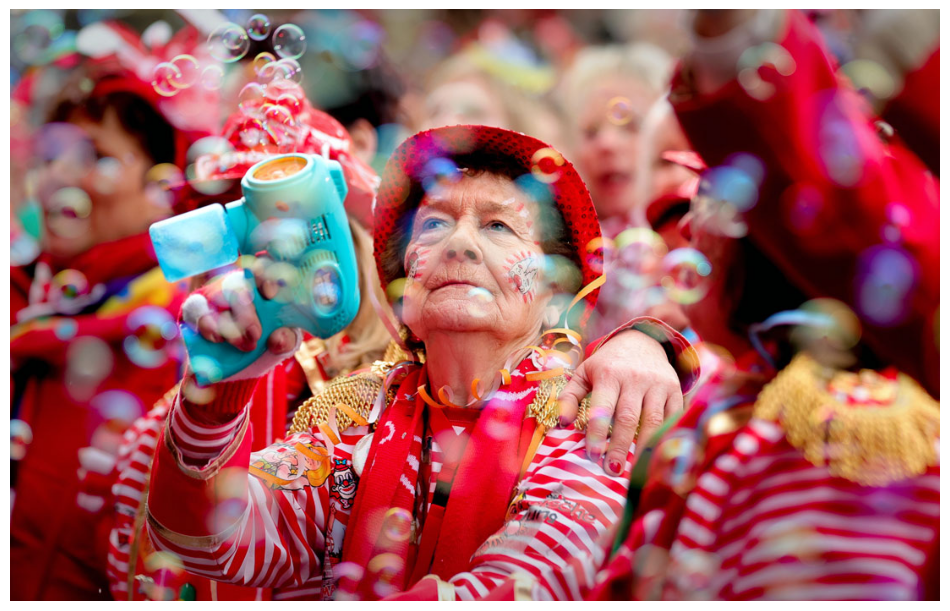

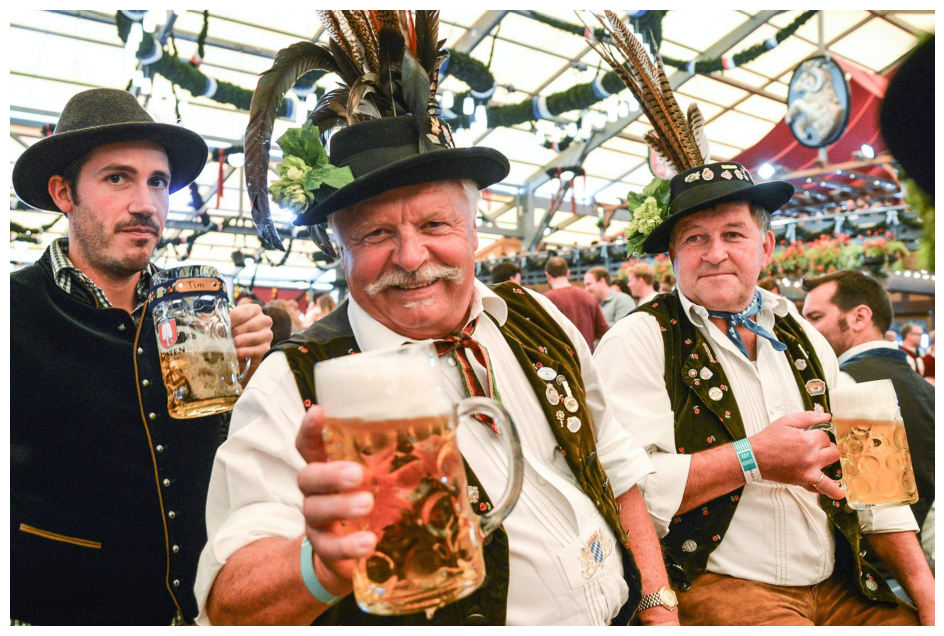

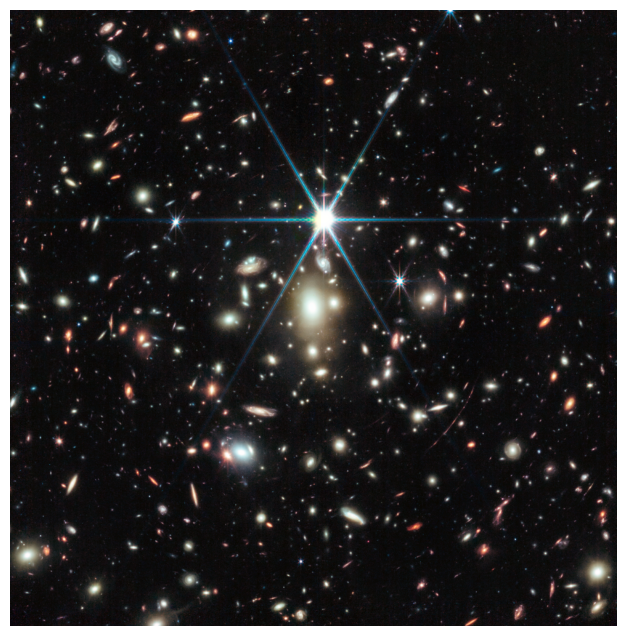

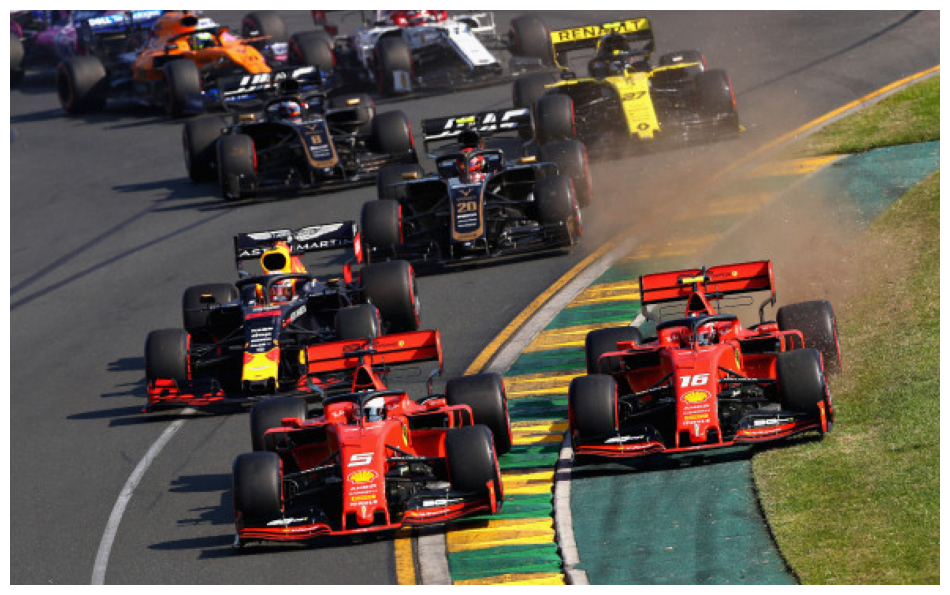

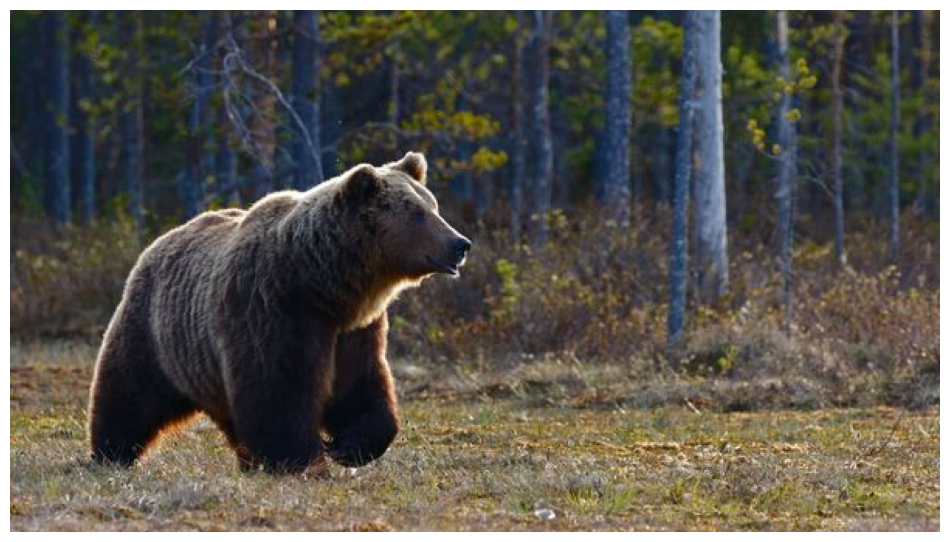

...

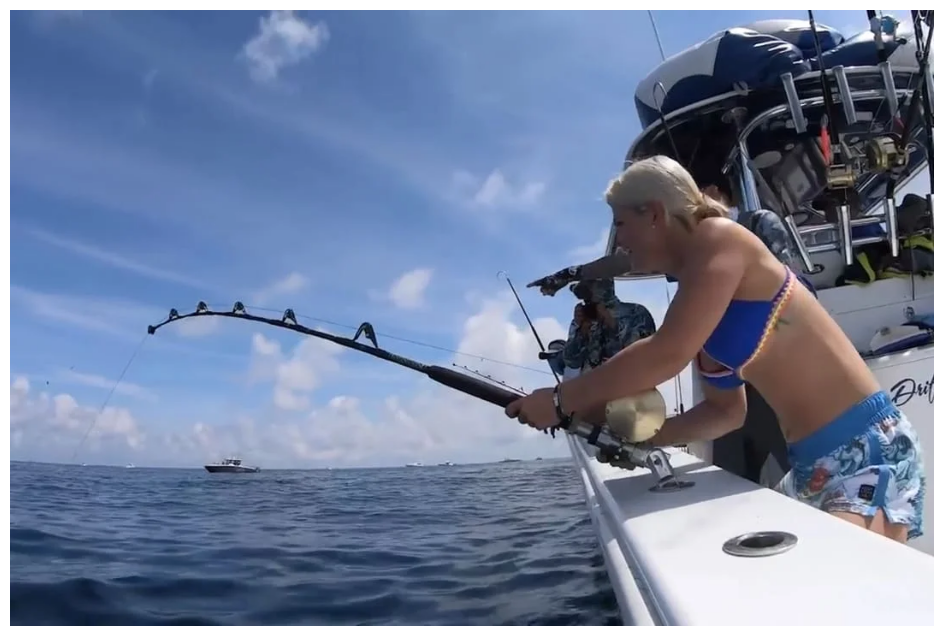

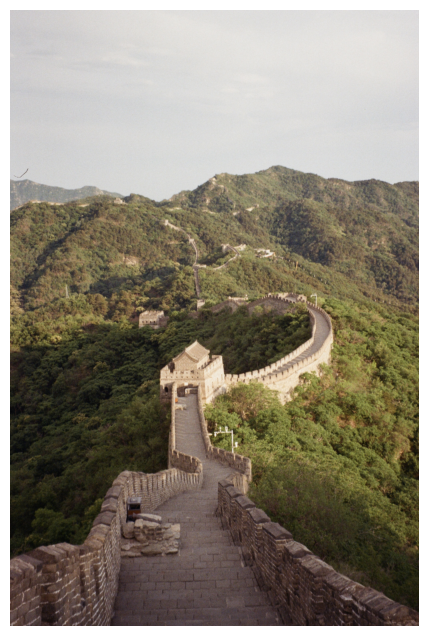

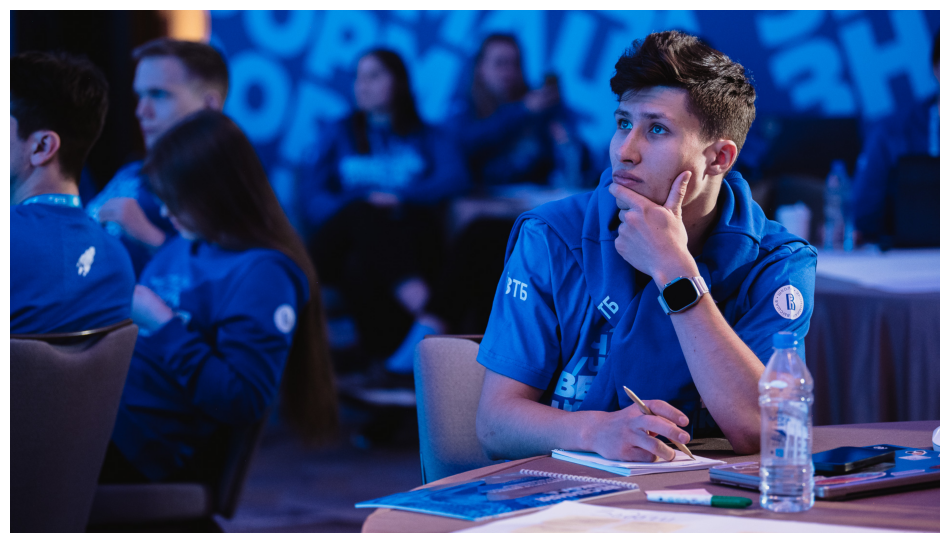

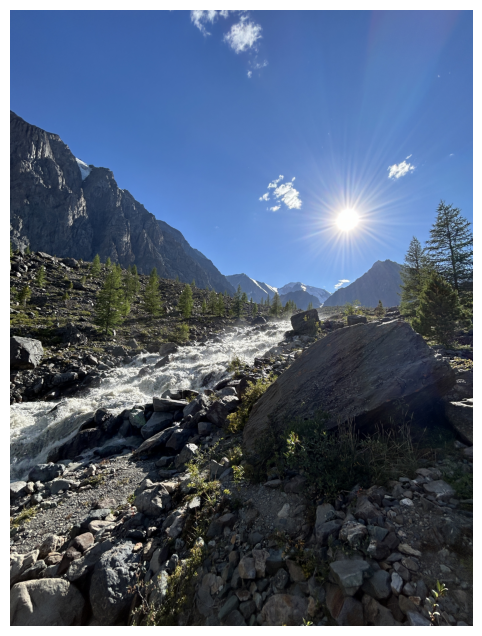

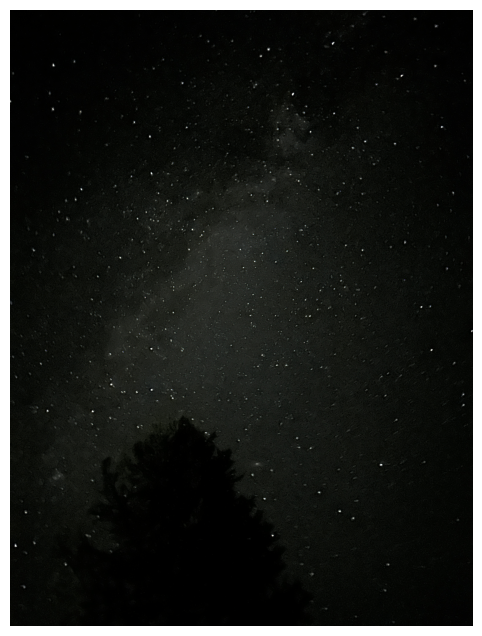

In [3]:
for im, _ in enumerate(data.values):
    plt.figure(figsize=(12,8))
    plt.imshow(data.loc[im, 'images'])
    plt.axis('off')
    plt.show()

In [3]:
data['perceptual_quality'] = [5, 4, 3, 3, 2, 3, 1, 4, 5, 3, 2, 4, 5, 1, 5, 1, 4, 5, 5, 3]
data.head()

,images,perceptual_quality
0,<PIL.Image.Image image mode=RGB size=1100x700 ...,5
1,<PIL.Image.Image image mode=RGB size=2048x1365...,4
2,<PIL.Image.Image image mode=RGB size=985x1001 ...,3
3,<PIL.Image.Image image mode=RGB size=590x365 a...,3
4,<PIL.Image.Image image mode=RGB size=600x337 a...,2


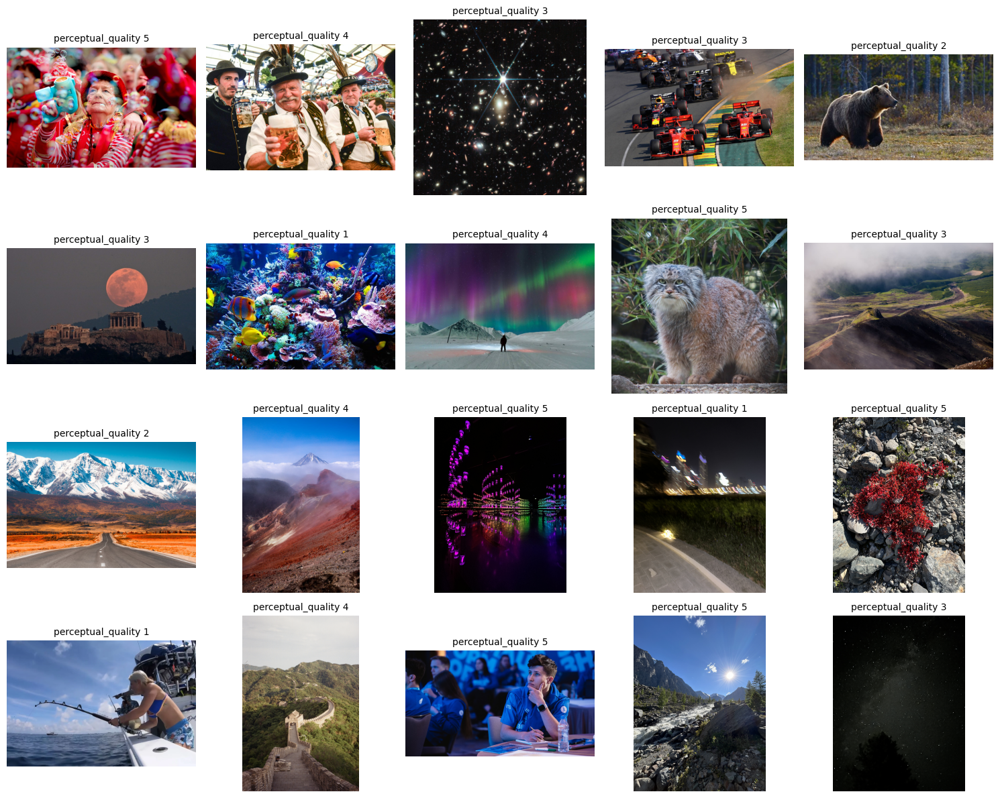

In [4]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(4, 5, figsize=(15, 12))

for i, (im, quality) in enumerate(zip(data['images'], data['perceptual_quality'])):
    row, col = divmod(i, 5) 
    ax = axes[row, col] 

    ax.imshow(im)
    ax.set_title(f'perceptual_quality {quality}', fontsize=10)
    ax.axis('off') 

plt.tight_layout()
plt.show()

# Define and calculate metrics

In [5]:
device = torch.device('mps' if torch.mps.is_available() else 'cpu')
device

device(type='mps')

In [6]:
nima = pyiqa.create_metric('nima', as_loss=False, device=torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

Loading pretrained model NIMA from /Users/roman14/.cache/torch/hub/pyiqa/NIMA_InceptionV2_ava-b0c77c00.pth


In [7]:
data['brisque_index'] = np.nan
data['tv_score'] = np.nan
data['nima_score'] = np.nan

for im, im_pil in enumerate(data['images']):
    im_pil = torch.tensor(np.array(im_pil)).permute(2, 0, 1)[None, ...] / 255
    im_pil.to(device)
    data.loc[im, 'brisque_index'] = piq.brisque(im_pil, data_range=1., reduction='none').item()
    data.loc[im, 'tv_score'] = piq.total_variation(im_pil).item()
    data.loc[im, 'nima_score'] = nima(im_pil.cpu()).cpu()[0][0].item()

Make a Min-Max normalization for clear ploting. We shouldn't forget that small brisque value better than bigger, so we have to invert values after their normalization. This procedure will help us to make clear interpretation  

In [8]:
data['brisque_index'] = 6 - (1 + (data['brisque_index'] - data['brisque_index'].min()) * (5 - 1) / (data['brisque_index'].max() - data['brisque_index'].min()))
data['tv_score'] = 1 + (data['tv_score'] - data['tv_score'].min()) * (5 - 1) / (data['tv_score'].max() - data['tv_score'].min())
data['nima_score'] = 1 + (data['nima_score'] - data['nima_score'].min()) * (5 - 1) / (data['nima_score'].max() - data['nima_score'].min())

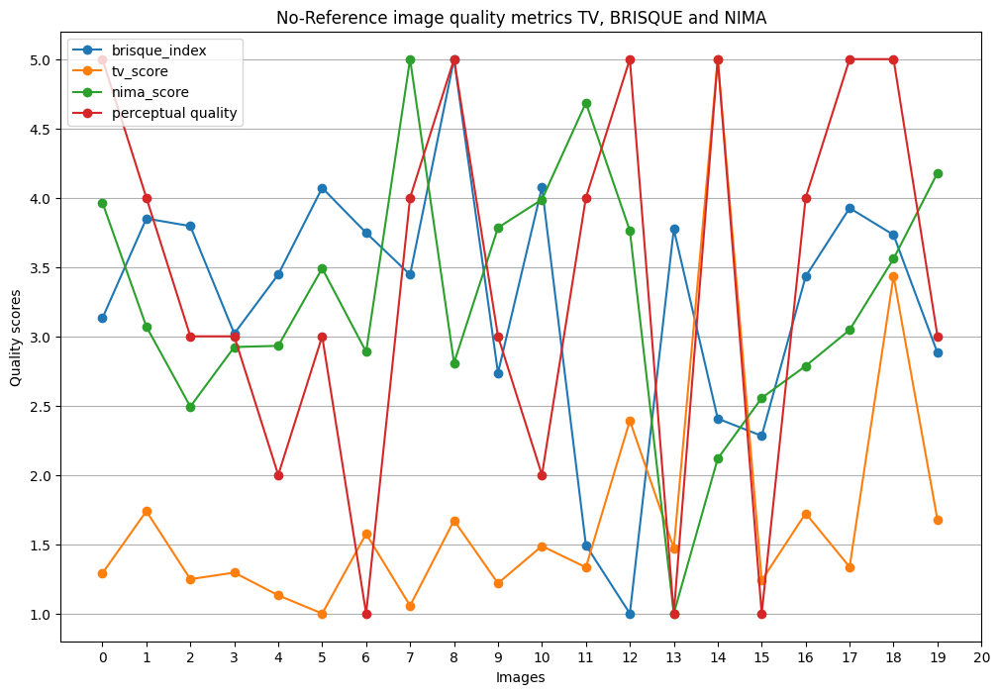

In [9]:
plt.figure(figsize=(12,8))
plt.plot(data['brisque_index'], label = 'brisque_index', marker = 'o')
plt.plot(data['tv_score'], label = 'tv_score', marker = 'o')
plt.plot(data['nima_score'], label = 'nima_score', marker = 'o')
plt.plot(data['perceptual_quality'], label = 'perceptual quality', marker = 'o')

plt.title('No-Reference image quality metrics TV, BRISQUE and NIMA')
plt.xticks(range(0, data.shape[0]+1, 1))
plt.legend()
plt.xlabel('Images')
plt.ylabel('Quality scores')
plt.grid(axis='y')

The BRISQUE index and NIMA score show some alignment with human-assigned perceptual quality, though they still vary independently at times, for example picture 12 has high mark but at the same time inverted BRISQUE index shows the worst point. The TV score tends to be lower on average, suggesting a more conservative approach in its quality assessment. This comparison highlights the discrepancies in how automated metrics correspond (or fail to correspond) with human perception, illustrating that certain images receive notably different scores from algorithmic evaluations compared to subjective judgments.

## Pearson Correlation and best metric

In [23]:
# The p-value roughly indicates the probability of an uncorrelated system producing datasets
# that have a Pearson correlation at least as extreme as the one computed from these datasets.

print(f"Pearson correlation coefficient for Brisque is {pearsonr(data['perceptual_quality'], data['brisque_index'])[0]:0.3f} \n"
      f"p-value for Brisque - {pearsonr(data['perceptual_quality'], data['brisque_index'])[1]:0.3f}\n")

print(f"Pearson correlation coefficient for TV is {pearsonr(data['perceptual_quality'], data['tv_score'])[0]:0.3f} \n"
    f"p-value for TV - {pearsonr(data['perceptual_quality'], data['tv_score'])[1]:0.3f}\n")


print(f"Pearson correlation coefficient for NIMA is {pearsonr(data['perceptual_quality'], data['nima_score'])[0]:0.3f} \n"
    f"p-value for NIMA - {pearsonr(data['perceptual_quality'], data['nima_score'])[1]:0.3f}")

Pearson correlation coefficient for Brisque is -0.103 
p-value for Brisque - 0.666

Pearson correlation coefficient for TV is 0.436 
p-value for TV - 0.055

Pearson correlation coefficient for NIMA is 0.331 
p-value for NIMA - 0.154


In [13]:
print(f"Pearson for brisque {pearsonr(data['perceptual_quality'], data['brisque_index'])}")

Pearson for brisque PearsonRResult(statistic=-0.10275179444519462, pvalue=0.6664131741670534)


Each p-value metric is bigger than 0.05, it means that there is no significant correlation with my subjective quality. However p-value for TV is the lowest among other

Lets also visualize pictures and image quality score metrics above on them

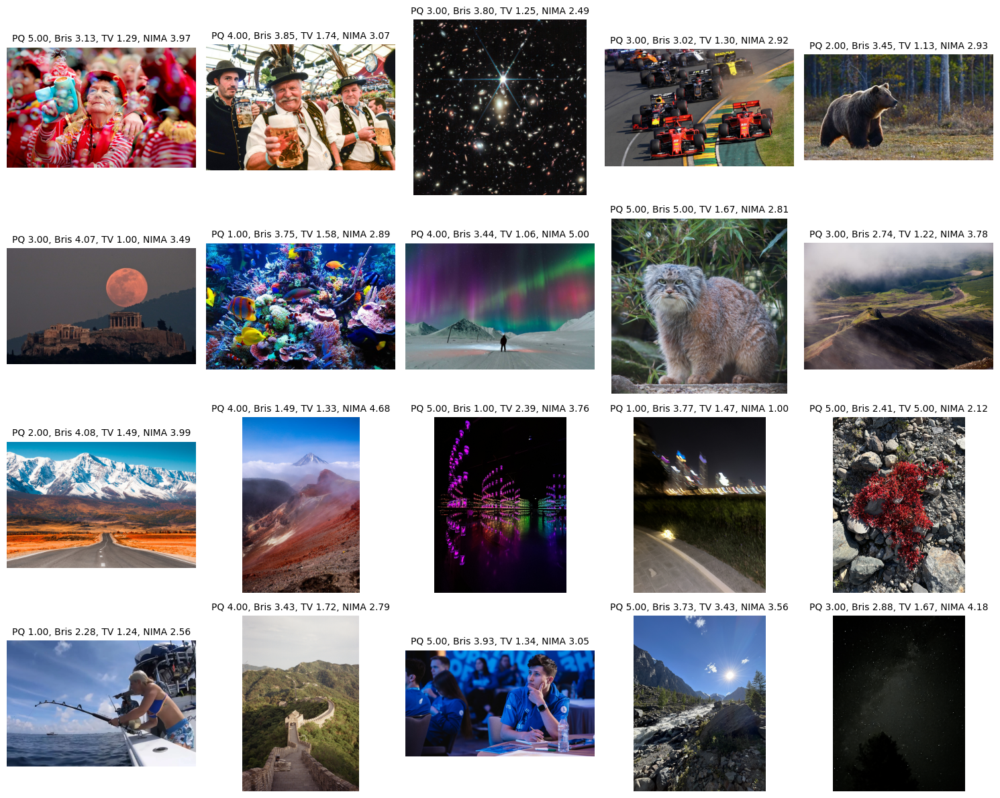

In [12]:
fig, axes = plt.subplots(4, 5, figsize=(15, 12))

for i, im in enumerate(data['images'].values):
    row, col = divmod(i, 5) 
    ax = axes[row, col] 

    ax.imshow(im)
    ax.set_title(f"PQ {data.loc[i, 'perceptual_quality']:0.2f}, Bris {data.loc[i, 'brisque_index']:0.2f}, TV {data.loc[i, 'tv_score']:0.2f}, NIMA {data.loc[i, 'nima_score']:0.2f}", fontsize=10)
    ax.axis('off') 

plt.tight_layout()
plt.show()

# Conclusion

The findings indicate that the BRISQUE, TV, and NIMA metrics do not correlate strongly with human evaluations of image quality, as evidenced by their non-significant p-values, particularly for BRISQUE (p = 0.666) and NIMA (p = 0.154). Although the TV score shows a marginally lower p-value (p = 0.055), it still does not reach a level of statistical significance. This points to a disparity between automated quality evaluations and human visual preferences within this dataset. Moreover this no hitting to the perceptual quality also can be connected with people individuality.